# Conditional Probability Assignment
## Abhishek Raje: BM22BTECH11002

### Loading Dataset

In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as mpim
import os
import numpy

In [2]:
dir_morning="/home/abhishek/Documents/workspace/Sem-5/Probabilty_Random_Processs/Conditional_Joint/Morning/"
dir_afternoon="/home/abhishek/Documents/workspace/Sem-5/Probabilty_Random_Processs/Conditional_Joint/Afternoon/"
dir_evening="/home/abhishek/Documents/workspace/Sem-5/Probabilty_Random_Processs/Conditional_Joint/Evening/"
dir_night="/home/abhishek/Documents/workspace/Sem-5/Probabilty_Random_Processs/Conditional_Joint/Night/"

In [3]:
def showdir(dir):
    files=os.listdir(dir)
    for file in files:
        img=mpim.imread(os.path.join(dir,file))
        plt.imshow(img)
        plt.show()

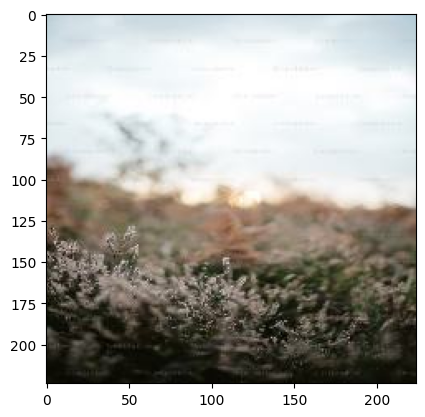

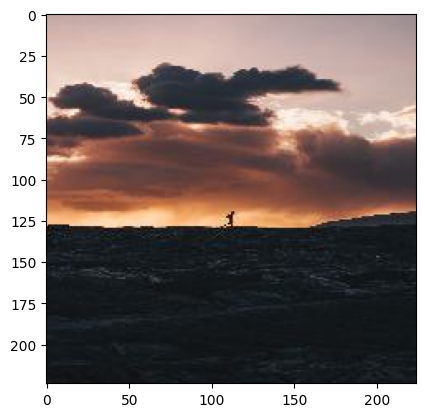

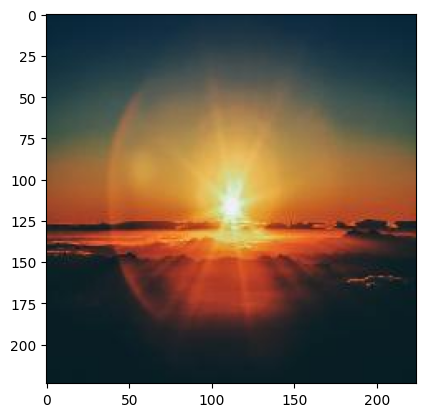

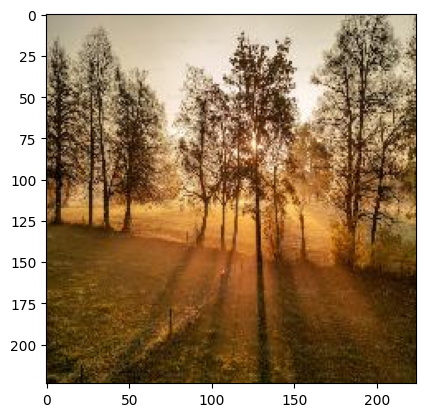

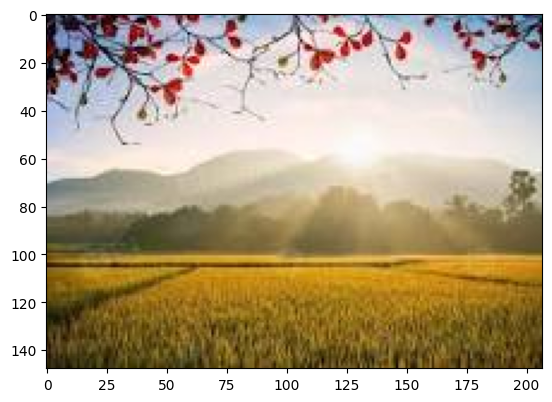

...

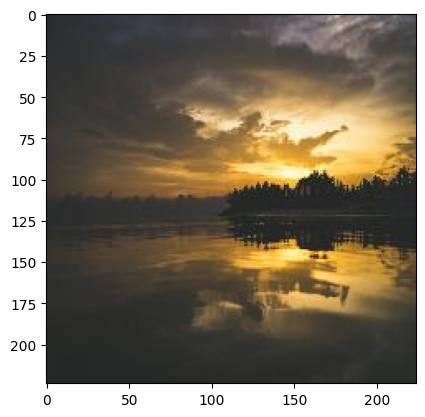

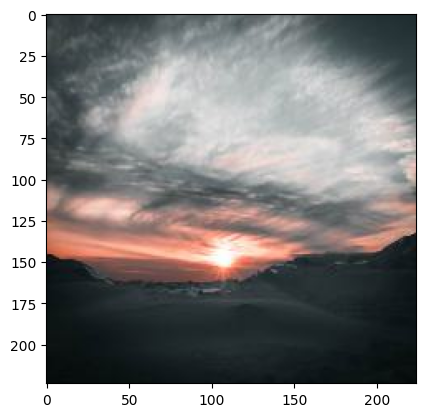

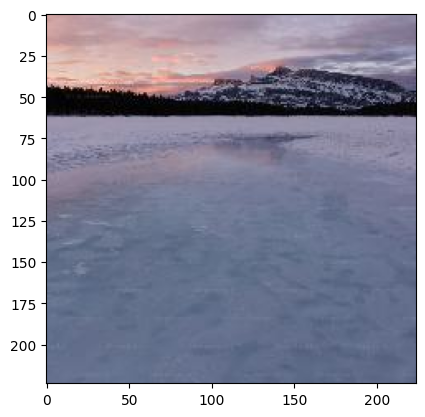

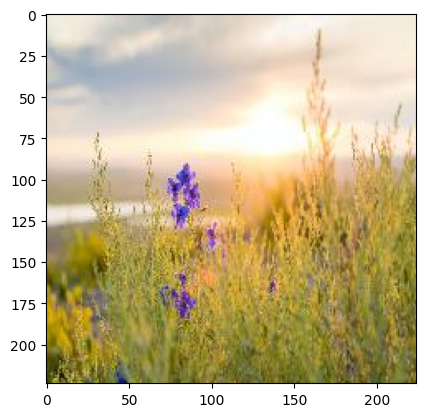

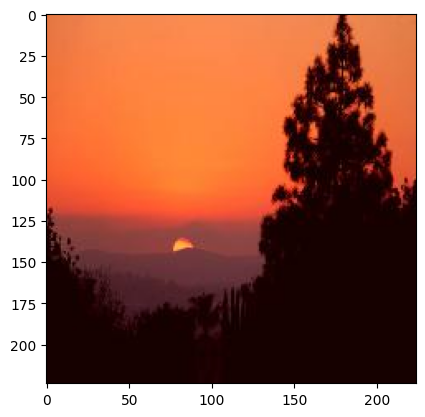

In [4]:
showdir(dir_morning)

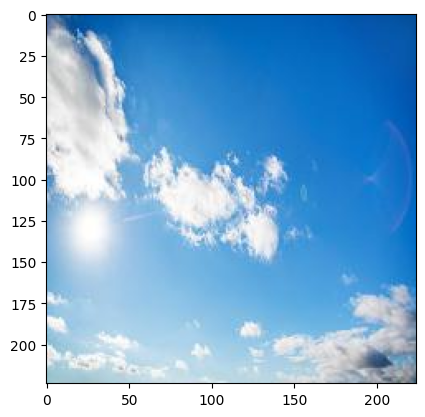

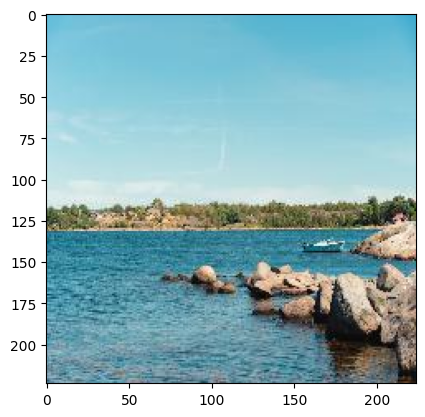

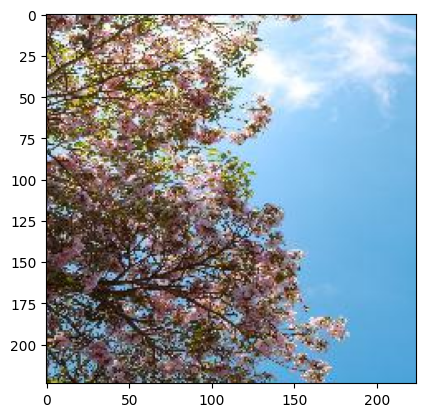

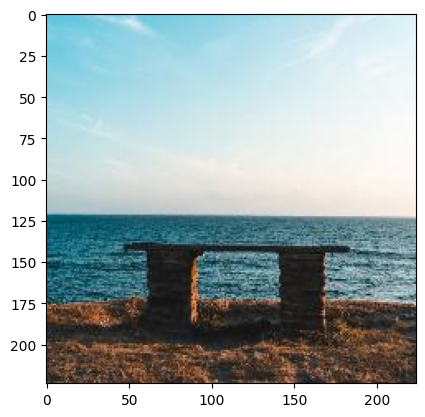

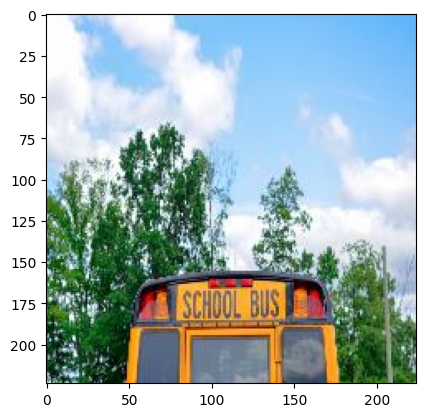

...

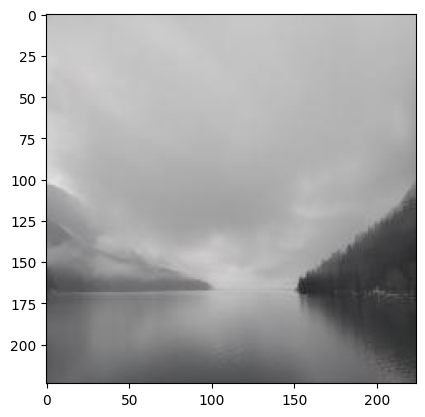

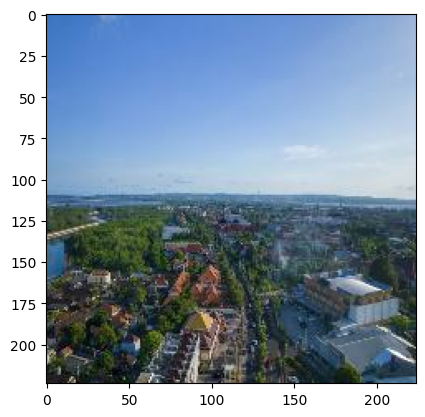

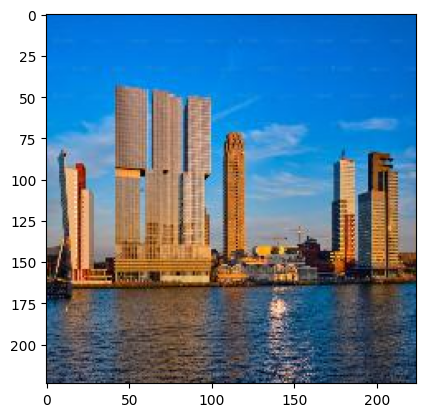

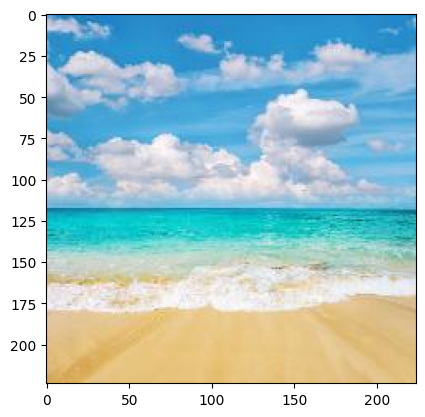

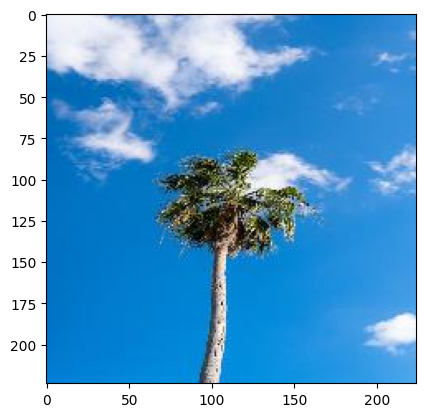

In [5]:
showdir(dir_afternoon)

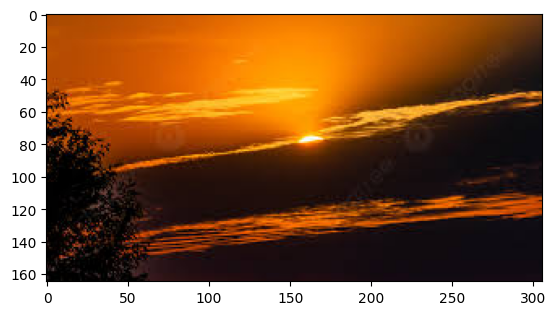

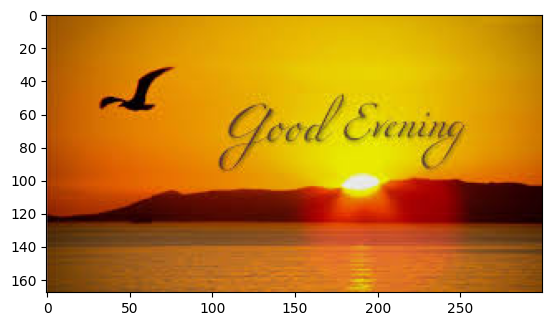

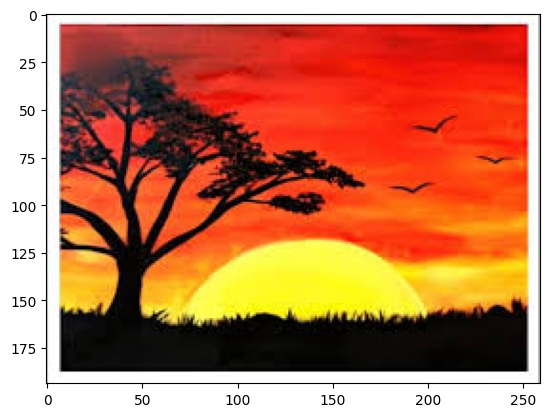

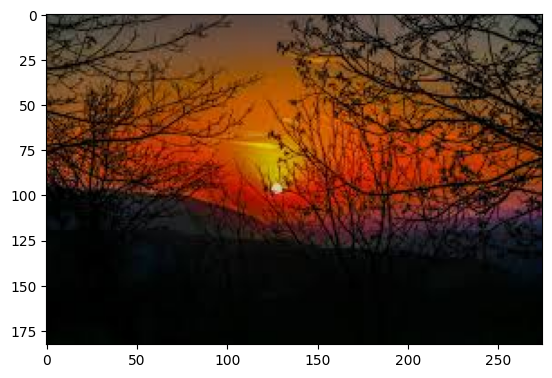

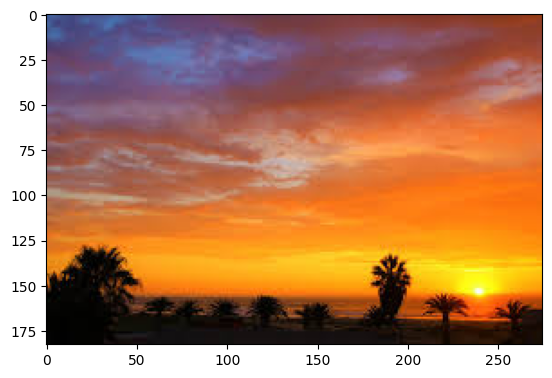

...

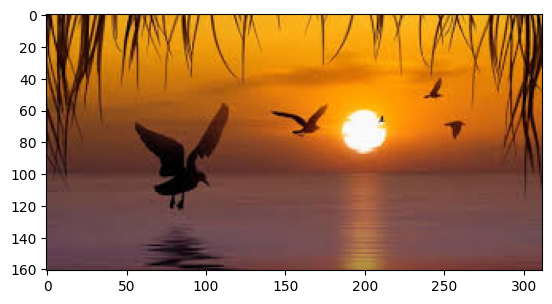

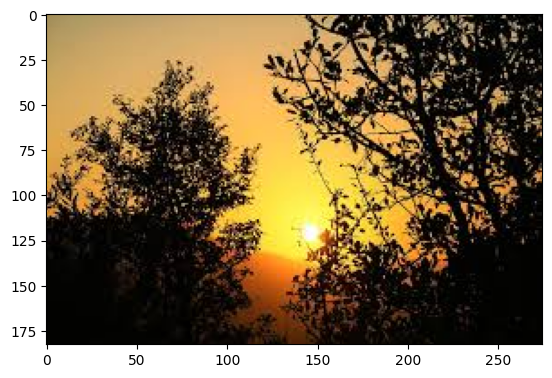

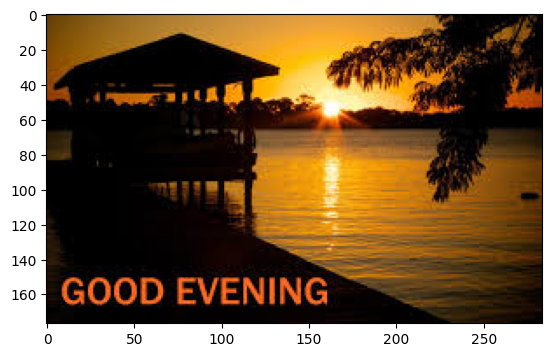

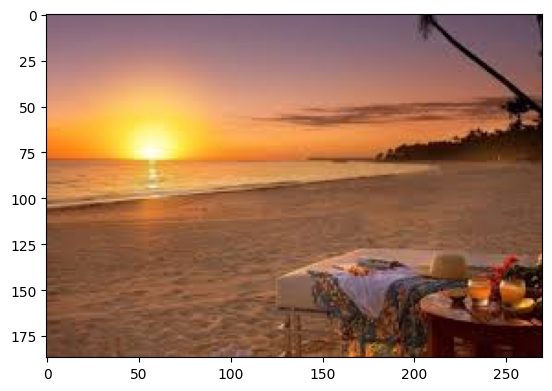

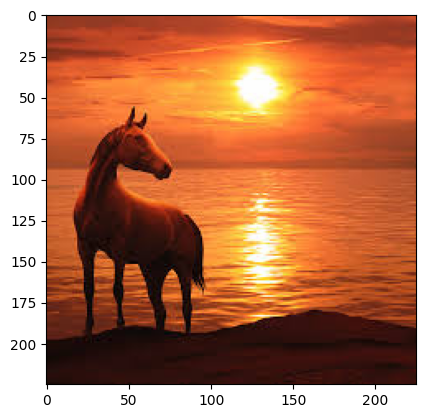

In [6]:
showdir(dir_evening)

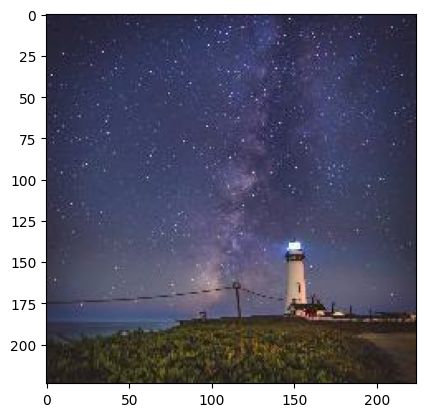

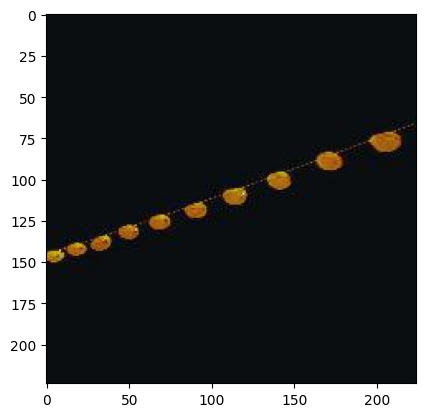

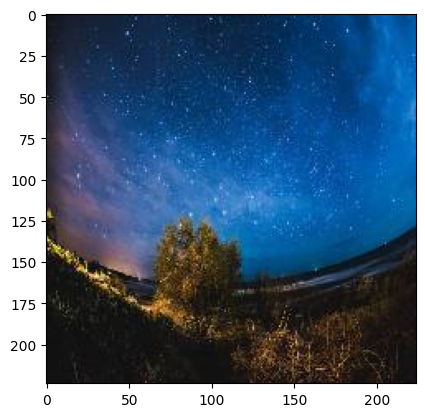

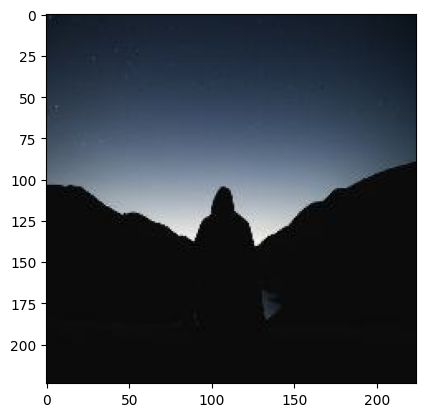

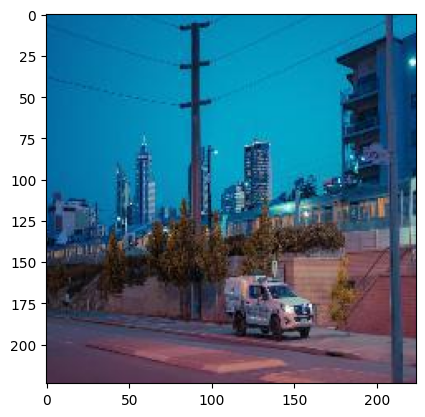

...

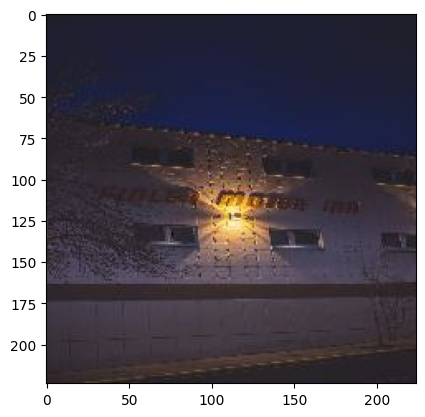

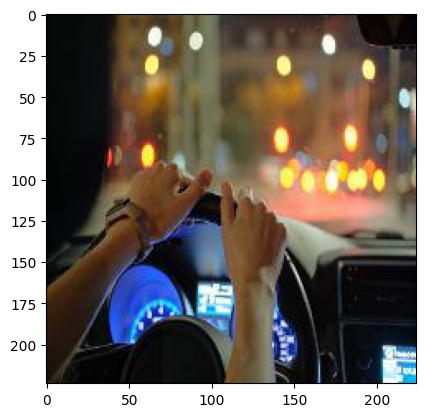

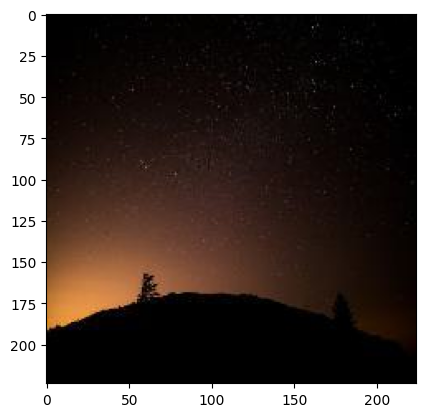

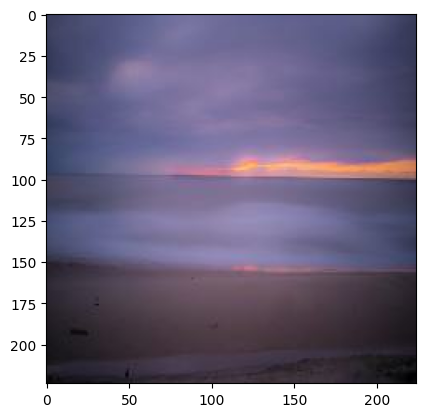

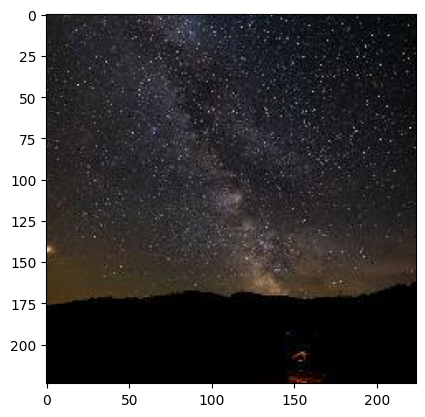

In [7]:
showdir(dir_night)

###  Probabilty density function given time

In [8]:
import os
import cv2
import numpy as np

In [9]:
dir_morning="/home/abhishek/Documents/workspace/Sem-5/Probabilty_Random_Processs/Conditional_Joint/Morning/"
dir_afternoon="/home/abhishek/Documents/workspace/Sem-5/Probabilty_Random_Processs/Conditional_Joint/Afternoon/"
dir_evening="/home/abhishek/Documents/workspace/Sem-5/Probabilty_Random_Processs/Conditional_Joint/Evening/"
dir_night="/home/abhishek/Documents/workspace/Sem-5/Probabilty_Random_Processs/Conditional_Joint/Night/"

In [10]:
def rgb_data(path_directory):
    rgb_data=[]
    file_names = os.listdir(path_directory)
    for file in file_names:
        img_path = os.path.join(path_directory, file)
        img=cv2.imread(img_path)
        ## averaging accross both the colums and row
        average_BGR = np.average(img, axis=(0, 1))
        average_RGB = average_BGR[::-1]
        rgb_data.append(average_RGB)
    rgb_data=np.array(rgb_data)
    comp_val=(rgb_data[:,0]+rgb_data[:,1]+rgb_data[:,2])/3
    return comp_val

In [11]:
comp_day=rgb_data(dir_morning)
comp_afternoon=rgb_data(dir_afternoon)
comp_evening=rgb_data(dir_evening)
comp_night=rgb_data(dir_night)

In [12]:
comp_day

array([157.39425888,  86.60212054,  75.04543341, 102.21633849,
       148.99600688,  82.36740673, 151.73330543, 124.01848825,
        93.70002259, 104.02972205, 124.26273517,  99.20239424,
        66.30193054,  50.99845212, 125.6385988 , 110.81575521,
        84.59328497,  80.41343803,  91.58104804,  99.64544312,
       125.8267432 ,  51.34008291,  88.22302163,  77.56444648,
       112.63594149, 182.14752073, 174.46423082,  98.54023836,
        94.88732329, 125.91759673,  96.28010736, 113.81645275,
        54.321495  , 138.5957297 ,  90.24329028,  81.06048044,
       144.27248087, 113.34701849,  79.36320153,  47.85751488,
       118.21864817, 109.32651068, 145.18922061, 128.96762685,
       111.25126887,  80.66804847, 110.15064971, 126.26438271,
       166.00965933,  77.86742001])

In [13]:
import seaborn as sns

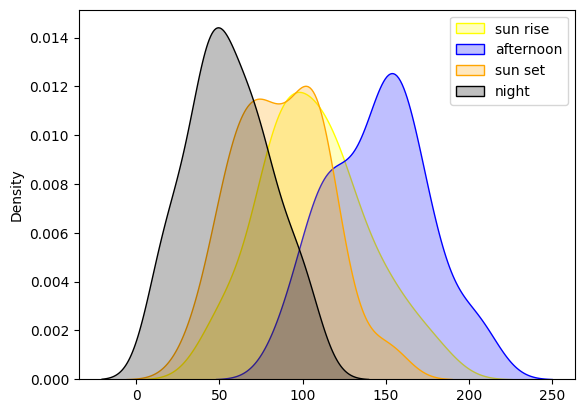

In [14]:
sns.kdeplot(comp_day,color="yellow",fill="True",label="sun rise")
sns.kdeplot(comp_afternoon,color="blue",fill="True",label="afternoon")
sns.kdeplot(comp_evening,color="orange",fill="True",label="sun set")
sns.kdeplot(comp_night,color="black",fill="True",label="night")
plt.legend()
plt.show()

In [15]:
time_of_day = np.concatenate([
    np.zeros_like(comp_day),        # 0 for Day
    np.ones_like(comp_afternoon),   # 1 for Afternoon
    2 * np.ones_like(comp_evening), # 2 for Evening
    3 * np.ones_like(comp_night)    # 3 for Night
])
intensity=[]

In [16]:
hist, xedges, yedges = np.histogram2d(time_of_day, intensity, bins=(4, 256))  # 4 bins for time of day, 256 for intensity

NameError: name 'intensity' is not defined

In [ ]:
import matplotlib.cm as cm


### Joint distribution of Time of Day & Intensity

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D

# Assuming xpos, ypos, zpos, dx, dy, dz are already defined...

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

norm = dz / dz.max()

# Choose a colormap (e.g., 'viridis', 'plasma', 'inferno', 'magma')
colors = cm.viridis(norm)

ax.bar3d(xpos, ypos, zpos, dx, dy, dz, zsort='average', color=colors)

# Labels and ticks
ax.set_xlabel('Time of Day')
ax.set_ylabel('Intensity')
ax.set_zlabel('Count')
ax.set_xticks([0.5, 1.5, 2.5, 3.5])
ax.set_xticklabels(['Morning', 'Afternoon', 'Evening', 'Night'])


plt.show()


### Conditional Probality  given Intensity

In [ ]:
dir_morning="/home/abhishek/Documents/workspace/Sem-5/Probabilty_Random_Processs/Conditional_Joint/Morning/"
dir_afternoon="/home/abhishek/Documents/workspace/Sem-5/Probabilty_Random_Processs/Conditional_Joint/Afternoon/"
dir_evening="/home/abhishek/Documents/workspace/Sem-5/Probabilty_Random_Processs/Conditional_Joint/Evening/"
dir_night="/home/abhishek/Documents/workspace/Sem-5/Probabilty_Random_Processs/Conditional_Joint/Night/"

In [ ]:
import os
import cv2

def Intensity_data(dir):
    intensity = []
    files = os.listdir(dir)
    for file in files:
        img_path = os.path.join(dir, file)
        img = cv2.imread(img_path)
        height, width, _ = img.shape
        
        x_choice, y_choice =( width // 2, height // 2)
        
        if x_choice + 1 < width and y_choice + 1 < height:
            I1 = sum(img[y_choice, x_choice]) // 3.0
            I2 = sum(img[y_choice + 1, x_choice]) // 3.0
            I3 = sum(img[y_choice, x_choice + 1]) // 3.0
            I4 = sum(img[y_choice + 1, x_choice + 1]) // 3.0
            intensity.append([I1, I2, I3, I4])
    intensity=np.array(intensity)
    return intensity


In [ ]:
I_morn=Intensity_data(dir_morning)
I1_morn=I_morn[:,0]
I2_morn=I_morn[:,1]
I3_morn=I_morn[:,2]
I4_morn=I_morn[:,3]
I1_morn

In [ ]:
I_afternoon=Intensity_data(dir_afternoon)
I1_after=I_afternoon[:,0]
I2_after=I_afternoon[:,1]
I3_after=I_afternoon[:,2]
I4_after=I_afternoon[:,3]

In [ ]:
I_evening=Intensity_data(dir_evening)
I1_even=I_evening[:,0]
I2_even=I_evening[:,1]
I3_even=I_evening[:,2]
I4_even=I_evening[:,3]

In [ ]:
I_night=Intensity_data(dir_night)
I1_night=I_evening[:,0]
I2_night=I_evening[:,1]
I3_night=I_evening[:,2]
I4_night=I_evening[:,3]

In [ ]:
I_total=I_morn+I_afternoon+I_evening+I_night
I1_tot=I_total[:,0]
I2_tot=I_total[:,1]
I3_tot=I_total[:,2]
I4_tot=I_total[:,3]

In [ ]:
from scipy.stats import  gaussian_kde 

### Applying Bayes Rule for Evaluating conditional probabilty

$$P(X \mid I_1, I_2, I_3, I_4) = \frac{f(I_1 \mid X) \cdot f(I_2 \mid X) \cdot f(I_3 \mid X) \cdot f(I_4 \mid X)}{\sum_{i} f(I_1 \mid B_i) \cdot f(I_2 \mid B_i) \cdot f(I_3 \mid B_i) \cdot f(I_4 \mid B_i) \cdot P(B_i)}$$


In [ ]:
def prob_time_given_Intensity(img_dir):
    img=cv2.imread(img_dir)
    ##Image Information
    height, width, _ = img.shape   
    x_choice, y_choice = width // 2, height // 2
    I1_image=np.sum(img[y_choice, x_choice])//3
    I2_image=np.sum(img[y_choice+1, x_choice])//3
    I3_image=np.sum(img[y_choice, x_choice+1])//3
    I4_image=np.sum(img[y_choice+1, x_choice+1])//3

    #Morn
    I1_given_day = gaussian_kde(I1_morn)
    I2_given_day = gaussian_kde(I2_morn)
    I3_given_day = gaussian_kde(I3_morn)
    I4_given_day = gaussian_kde(I4_morn)

    #Afternoon
    I1_given_after = gaussian_kde(I1_after)
    I2_given_after = gaussian_kde(I2_after)
    I3_given_after = gaussian_kde(I3_after)
    I4_given_after = gaussian_kde(I4_after)

    #Evening
    I1_given_even = gaussian_kde(I1_even)
    I2_given_even = gaussian_kde(I2_even)
    I3_given_even = gaussian_kde(I3_even)
    I4_given_even = gaussian_kde(I4_even)

    #Night
    I1_given_night = gaussian_kde(I1_night)
    I2_given_night = gaussian_kde(I2_night)
    I3_given_night = gaussian_kde(I3_night)
    I4_given_night = gaussian_kde(I4_night)
    
    p_day = I1_given_day(I1_image) * I2_given_day(I2_image) * I3_given_day(I3_image) * I4_given_day(I4_image)
    p_after = I1_given_after(I1_image) * I2_given_after(I2_image) * I3_given_after(I3_image) * I4_given_after(I4_image)
    p_even = I1_given_even(I1_image) * I2_given_even(I2_image) * I3_given_even(I3_image) * I4_given_even(I4_image)
    p_night = I1_given_night(I1_image) * I2_given_night(I2_image) * I3_given_night(I3_image) * I4_given_night(I4_image)

    prob_day = p_day / (p_day + p_after + p_even + p_night)    
    prob_after = p_after/ (p_day + p_after + p_even + p_night)    
    prob_even = p_even / (p_day + p_after + p_even + p_night)    
    prob_night = p_night / (p_day + p_after + p_even + p_night)    
    return (prob_day,prob_after,prob_even,prob_night)

In [ ]:
import matplotlib.image as mpimg

In [ ]:
img_dir="/home/abhishek/Documents/workspace/Sem-5/Probabilty_Random_Processs/Conditional_Joint/evening.jpeg"
img=mpimg.imread(img_dir)
img_plot=plt.imshow(img)
plt.show()

In [ ]:
prob_val=np.array(prob_time_given_Intensity(img_dir))
prob_val

In [ ]:
time_labels = ['Morning', 'Afternoon', 'Evening', 'Night']
prob_val = np.array(prob_time_given_Intensity(img_dir))
prob_val = prob_val.flatten()

plt.bar(time_labels, height=prob_val, color='pink')


In [ ]:
prob_time_given_Intensity(img_dir)

In [ ]:
img_dir="/home/abhishek/Documents/workspace/Sem-5/Probabilty_Random_Processs/Conditional_Joint/afternoon.jpeg"
img=mpimg.imread(img_dir)
img_plot=plt.imshow(img)
plt.show()

In [ ]:
time_labels = ['Morning', 'Afternoon', 'Evening', 'Night']
prob_val = np.array(prob_time_given_Intensity(img_dir))
prob_val = prob_val.flatten()

plt.bar(time_labels, height=prob_val, color='pink')


In [ ]:
img_dir="/home/abhishek/Documents/workspace/Sem-5/Probabilty_Random_Processs/Conditional_Joint/night.jpeg"
img=mpimg.imread(img_dir)
img_plot=plt.imshow(img)
plt.show()

In [ ]:
prob_time_given_Intensity(img_dir)

In [ ]:
time_labels = ['Morning', 'Afternoon', 'Evening', 'Night']
prob_val = np.array(prob_time_given_Intensity(img_dir))
prob_val = prob_val.flatten()

plt.bar(time_labels, height=prob_val, color='pink')
